In [1]:
%%bash
pip install astropy photutils astroquery scikit-image

  Obtaining dependency information for astropy from https://files.pythonhosted.org/packages/5a/f7/c7030f9d1190bcc49564432a4cb536494aecd7d3fcb654cc5d604c802607/astropy-5.3.2-cp311-cp311-macosx_11_0_arm64.whl.metadata
  Obtaining dependency information for photutils from https://files.pythonhosted.org/packages/57/ae/027bd894ca88dc26139ab828cc59180631d1b644e3b4088c2e4e78847ef9/photutils-1.9.0-cp311-cp311-macosx_11_0_arm64.whl.metadata
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 30.1 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 333.3/333.3 kB 34.6 MB/s eta 0:00:00
  Using cached html5lib-1.1-py2.py3-none-any.whl (112 kB)
  Obtaining dependency information for keyring>=4.0 from https://files.pythonhosted.org/packages/0e/8f/5772801169cf62e8232721034f91f81e33b0cfa6e51d3bf6ff65c503af2a/keyring-24.2.0-py3-none-any.whl.metadata
  Obtaining dependency information for pyvo>=1.1 from https://files.pythonhosted.org/packages/6f/d3/ce8d1ec673464caf53cf4f85d195f73

In [137]:
from matplotlib import pyplot as plt


def show(im, display=True):
    plt.figure(figsize=(50, 50))
    plt.imshow(im, cmap='gray')
    plt.axis("off")
    if display:
        plt.show()


def show_with_stars(im, x_coords, y_coords):
    show(im, display=False)
    marker_size = (image_data.shape[0] // 20) ** 2  # Size as 1/20th of the image
    plt.scatter(x_coords, y_coords, s=marker_size, facecolor='r', marker='+')
    plt.show()


def pixel_size():
    sensor_width_mm = 22.3  # Sensor width in mm for Canon M5
    resolution_width_pixels = 6000  # Resolution width in pixels for Canon M5

    # Calculate pixel size
    pixel_size_mm = sensor_width_mm / resolution_width_pixels  # in mm
    return pixel_size_mm * 1000


def pixel_scale():
    focal_length_mm = 55  # Focal length in mm for the telephoto lens at 55mm zoom
    focal_length_error_mm = 2
    # Calculate pixel scale
    pixel_scale = 206.265 * pixel_size() / focal_length_mm  # in arcsec/pixel
    pixel_scale_upper = 206.265 * pixel_size() / (focal_length_mm - focal_length_error_mm)
    pixel_scale_lower = 206.265 * pixel_size() / (focal_length_mm + focal_length_error_mm)

    # print(f"Pixel Size: {pixel_size_mm:.6f} mm")
    # print(f"Pixel Scale: {pixel_scale:.6f} arcsec/pixel")
    return pixel_scale, pixel_scale_upper, pixel_scale_lower


def cutout(image_data, pos=None, size=1000):
    if not pos:
        pos = (image_data.shape[0] / 2, image_data.shape[1] / 2)
    cutout = nddata.Cutout2D(image_data, pos, size)
    show(cutout.data)
    image_data = cutout.data
    return image_data



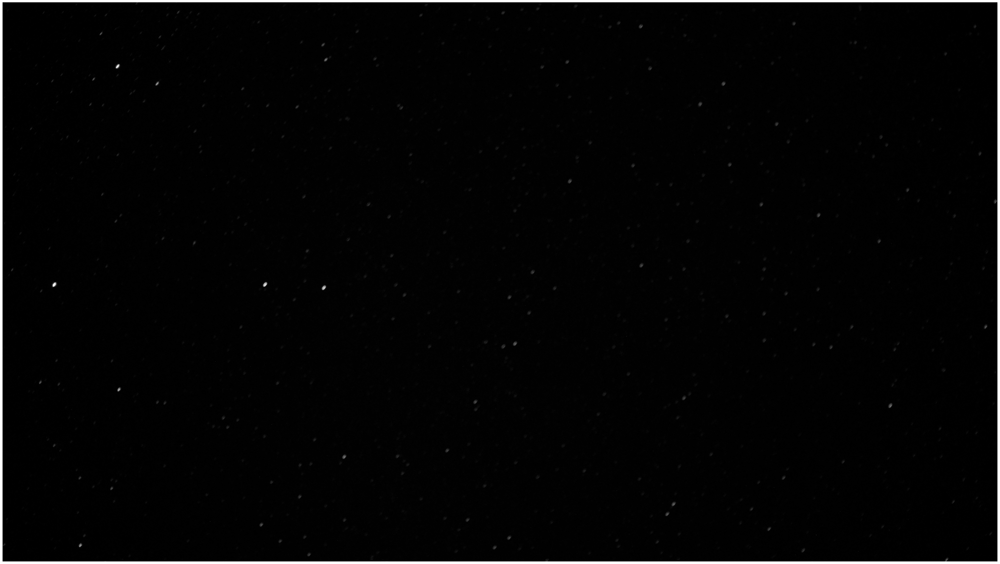

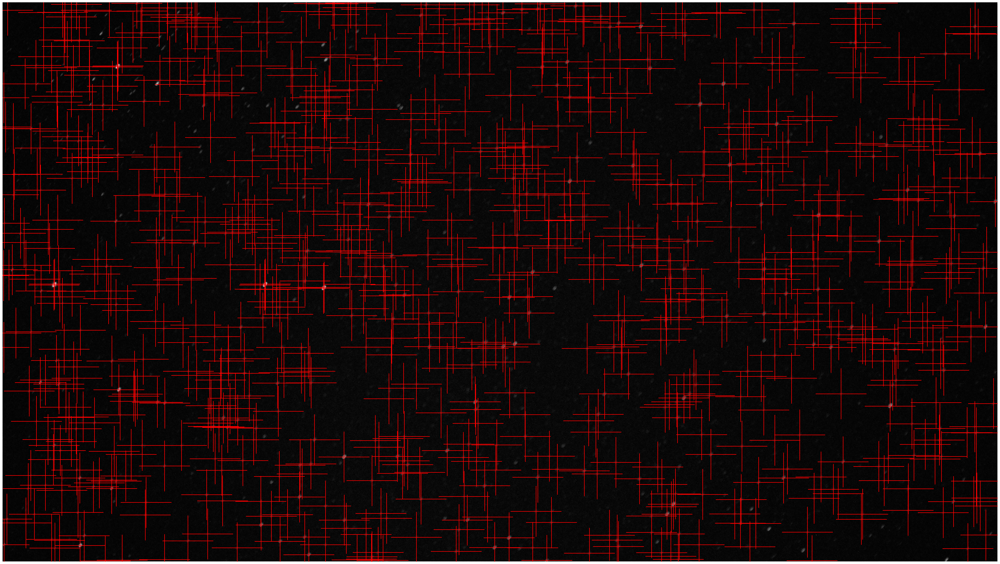

id,xcentroid,ycentroid,sharpness,roundness1,roundness2,npix,sky,peak,flux,mag
int64,float64,float64,float64,float64,float64,int64,float64,float64,float64,float64
108,589.4607295342591,332.1109404535184,0.3716394981432841,-0.8624317452948879,0.1084330067262193,361,0.0,0.9724886274509805,14.524631367135397,-2.905262797191115
422,263.23794499817177,1455.9930882552162,0.35028651760453594,-0.6609097525078264,0.24963990306646744,361,0.0,0.9876470588235293,14.279637489692952,-2.886792955886043
421,1348.2383828486318,1455.6269176834123,0.3194333404050633,-0.6969444767751509,-0.019984646219629962,361,0.0,0.9102243137254902,13.555692055701375,-2.830304236052795
104,594.424590406791,326.7527301439627,0.3422876333185865,-0.8532959358251967,0.2585837093154522,361,0.0,0.8914435294117647,13.470792175684279,-2.8234828399778964
566,597.6571964751315,1994.5247828330728,0.3540488135360126,-0.8396079031046438,0.2774987522662386,361,0.0,0.7786835294117647,12.967429002890505,-2.782134697238128
765,399.0506344989615,2796.6858501231923,0.3413650363406522,-0.7695933147304987,0.24648897295547587,361,0.0,0.7034607843137255,12.23192971711833,-2.7187374425469226
416,268.31146677131017,1450.5474896460394,0.3071998052661913,-0.6168074647475279,0.18997538098496725,361,0.0,0.8955435294117647,12.21078423725232,-2.716858893476818
426,1650.8802489391471,1472.3036112190632,0.34535957286035873,-0.6134393929052586,0.006804750365733678,361,0.0,0.8412956862745098,12.010896201039591,-2.698938534461685
417,1353.131613555612,1450.3678070092299,0.28437707407335194,-0.5663881626398319,0.2973085937186485,361,0.0,0.8157941176470588,11.413795050952972,-2.6435751749481273


Found 788 stars


In [139]:
from astropy.io import fits
from photutils.detection import DAOStarFinder
import numpy as np
from skimage import color, io, exposure
from astropy import nddata
from astroquery.astrometry_net import AstrometryNet
from astropy.wcs import WCS
import tempfile

# 1. Star Identification using Photutils
image_path = '../input/Night sky.jpg'
image_rgb = io.imread(image_path)
image_gray = color.rgb2gray(image_rgb)  # Convert to grayscale
image_data = image_gray
# show(image_gray)
# image_data = (image_data * 65535).astype(np.uint16)  # Scale to 16-bit
# show(image_data)

# image_data = cutout(image_data)
# print(image_data[10][10:20])

daofind = DAOStarFinder(threshold=10.0 * np.std(image_data), fwhm=15.0)
sources = daofind(image_data)
sources.sort('flux')
sources.reverse()
# sources = sources[:100]
show(exposure.adjust_gamma(image_data, gamma=1.5))
show_with_stars(image_data, sources['xcentroid'], sources['ycentroid'])
display(sources)
# show(image_data)
print(f"Found {len(sources)} stars")

In [134]:
from astropy import table
from astroquery import astrometry_net

# Save sources as a temporary FITS file for plate solving
# hdu = fits.PrimaryHDU(image_data)
# hdulist = fits.HDUList([hdu])
# with tempfile.NamedTemporaryFile(delete=False, suffix='.fits') as tmp:
#     hdulist.writeto(tmp)
#     tmp_path = tmp.name

# 2. Plate solving using Astrometry.net
ast = astrometry_net.AstrometryNet()
ast.api_key = ''

scale, scale_upper, scale_lower = pixel_scale()
print(scale)
# ast.show_allowed_settings()
sources_for_astrometry = table.Table()
wcs_header = ast.solve_from_source_list(
    sources['xcentroid'], sources['ycentroid'],
    image_data.shape[1], image_data.shape[0],
    # scale_units='arcsecperpix',
    # scale_type='ul',
    # scale_upper=scale_upper,
    # scale_lower=scale_lower,
    solve_timeout=120, parity=2)

print(wcs_header)
if wcs_header is not None:
    orientation = wcs_header['CROTA2']
    field_of_view = wcs_header['FOV']
    print(f"Orientation: {orientation} degrees")
    print(f"Field of View: {field_of_view} degrees")
else:
    print("Could not solve the plate.")


13.938513636363636
Solving........................................SIMPLE  =                    T / Standard FITS file                             BITPIX  =                    8 / ASCII or bytes array                           NAXIS   =                    0 / Minimal header                                 EXTEND  =                    T / There may be FITS ext                          WCSAXES =                    2 / no comment                                     CTYPE1  = 'RA---TAN-SIP' / TAN (gnomic) projection + SIP distortions            CTYPE2  = 'DEC--TAN-SIP' / TAN (gnomic) projection + SIP distortions            EQUINOX =               2000.0 / Equatorial coordinates definition (yr)         LONPOLE =                180.0 / no comment                                     LATPOLE =                  0.0 / no comment                                     CRVAL1  =        344.532133057 / RA  of reference point                         CRVAL2  =        27.9469358767 / DEC of reference poin

KeyError: "Keyword 'CROTA2' not found."

('SIMPLE', True, 'Standard FITS file')
('BITPIX', 8, 'ASCII or bytes array')
('NAXIS', 0, 'Minimal header')
('EXTEND', True, 'There may be FITS ext')
('WCSAXES', 2, 'no comment')
('CTYPE1', 'RA---TAN-SIP', 'TAN (gnomic) projection + SIP distortions')
('CTYPE2', 'DEC--TAN-SIP', 'TAN (gnomic) projection + SIP distortions')
('EQUINOX', 2000.0, 'Equatorial coordinates definition (yr)')
('LONPOLE', 180.0, 'no comment')
('LATPOLE', 0.0, 'no comment')
('CRVAL1', 344.532133057, 'RA  of reference point')
('CRVAL2', 27.9469358767, 'DEC of reference point')
('CRPIX1', 483.451957003, 'X reference pixel')
('CRPIX2', 1260.87627051, 'Y reference pixel')
('CUNIT1', 'deg', 'X pixel scale units')
('CUNIT2', 'deg', 'Y pixel scale units')
('CD1_1', -0.00286181578728, 'Transformation matrix')
('CD1_2', 0.00320473449511, 'no comment')
('CD2_1', -0.0032190173063, 'no comment')
('CD2_2', -0.00286204890271, 'no comment')
('IMAGEW', 5120, 'Image width,  in pixels.')
('IMAGEH', 2879, 'Image height, in pixels.')


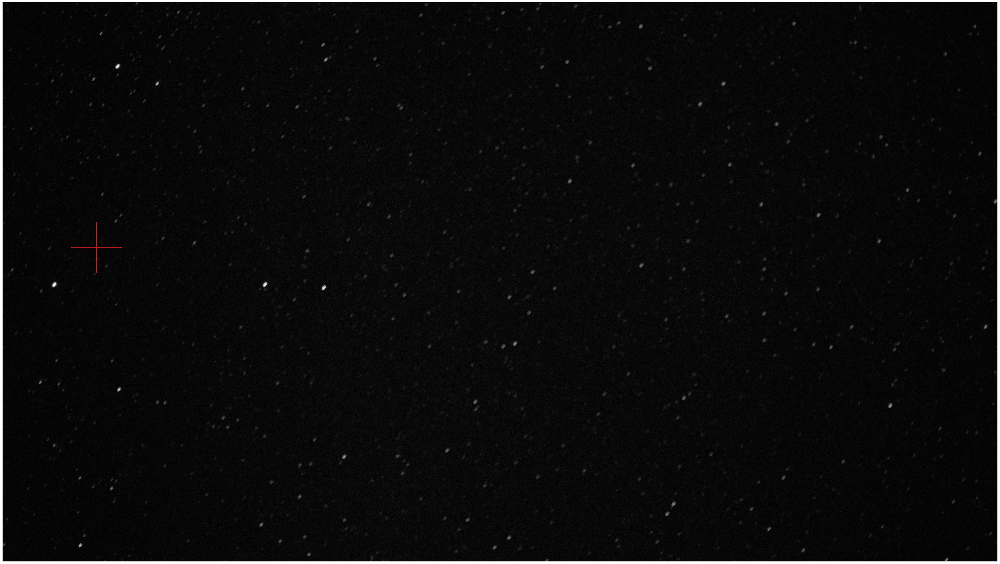

In [136]:
from astropy.io import fits

print(wcs_header.cards)
show_with_stars(image_data, wcs_header['CRPIX1'], wcs_header['CRPIX2'])
# print(help(wcs_header))